In [9]:
%load_ext autoreload
%autoreload 2

import numpy as np
import pandas as pd
import warnings
import matplotlib.pyplot as plt
from huggingface_hub import snapshot_download
import sys

sys.path.append('..')
from core.client import ModelAPIClient
from project_datasets import loader
from config import tasks, models
from core.analysis import Visualizer

from config import tasks
from pathlib import Path

# Paths
FIGURES_DIR = Path('../figures/experiments/')
RESULTS_DIR = Path('../results')
RUNS_DIR = Path('../results/runs')

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Headline Result - Figure 1

Fetching 113 files: 100%|███████████████████| 113/113 [00:00<00:00, 4042.24it/s]


Downloaded to: /Users/lguerdan/.cache/huggingface/hub/datasets--lguerdan--indeterminacy-experiments/snapshots/d009e71909eb242952bea8bd5475d6c27d22a1ff/runs/main-run


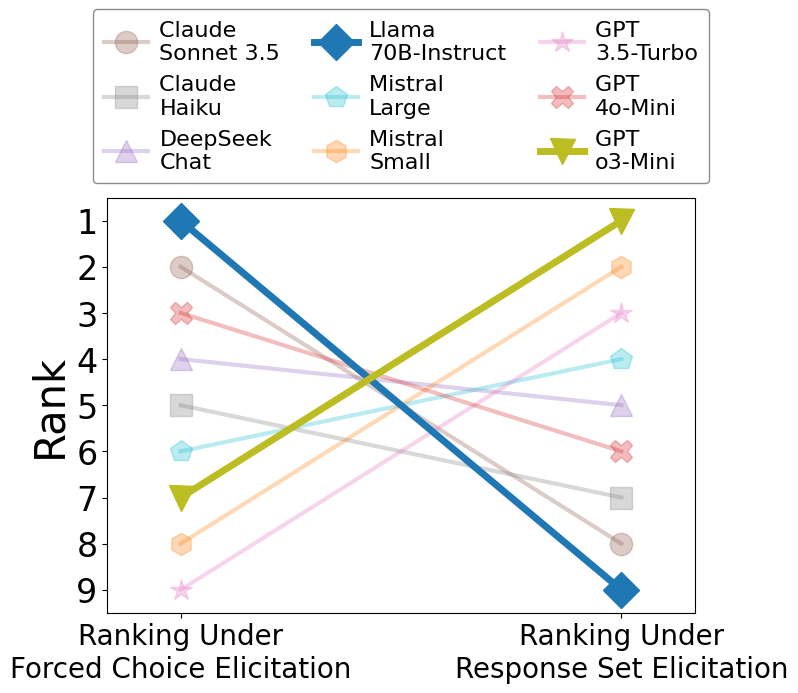

In [5]:
client = ModelAPIClient(
    tasks.TASK_CONFIGS,
    models.MODELS
)

run_results = client.load_run(
    results_path=RUNS_DIR,
    run_tag='main-run',
    use_hf=True #Downloads existing run from HuggingFace. Set to False for loading an existing run.
)

visualizer = Visualizer()
rank_df = visualizer.score_judges_subsample(
    run_results,
    task_name='civil_comments',
    betas=np.array([0, 0.3]), 
    taus= np.arange(0,1.1,.1), 
    resample=False,
    n_samples=10,
    items_per_sample=100,
    random_seed=100
)

visualizer.plot_headline_figure(
    task_name = 'civil_comments',
    rank_df = rank_df,
    tau_value = 0.5,
    betas=np.array([0, 0.3]),
    downstream_metric = 'consistency',
    display_names=models.DISPLAY_NAMES,
    metric_lower_is_better=False
)

plt.savefig(FIGURES_DIR / 'headline_figure.pdf', dpi=500, bbox_inches='tight')




## Aggregate Regret Analysis - Figure 4

Load and pre-process raw runs data if it hasn't already been cached 

Fetching 113 files: 100%|███████████████████| 113/113 [00:00<00:00, 4107.43it/s]

Downloaded to: /Users/lguerdan/.cache/huggingface/hub/datasets--lguerdan--indeterminacy-experiments/snapshots/d009e71909eb242952bea8bd5475d6c27d22a1ff/runs/main-run


Loading cached results...


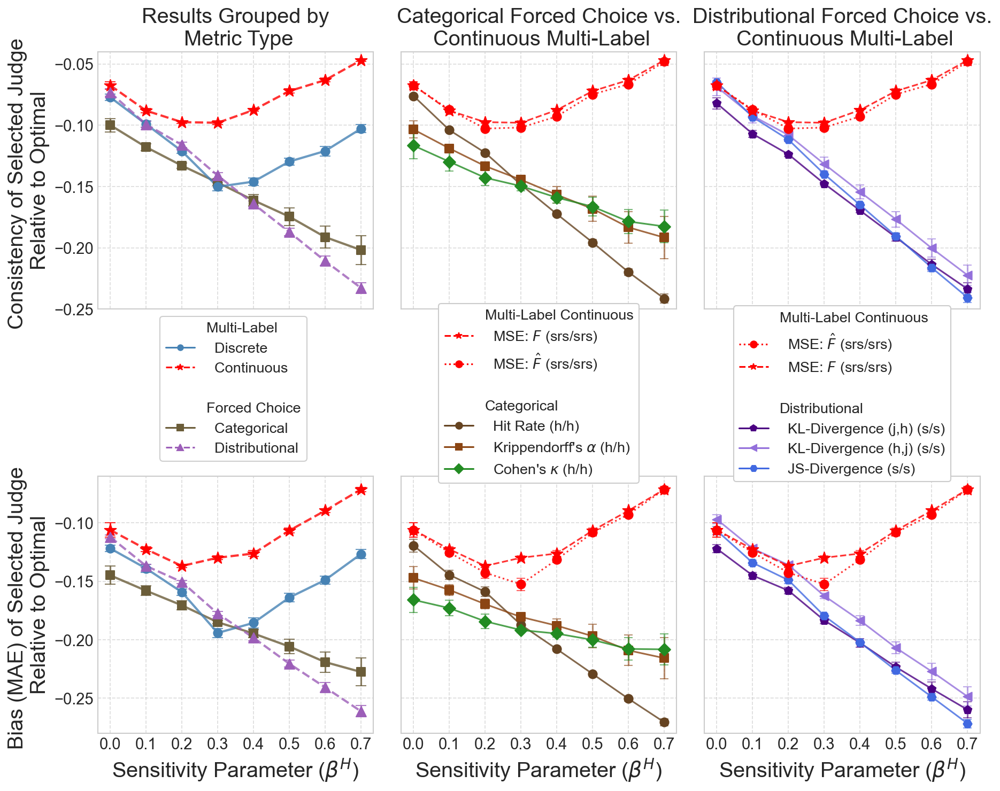

In [6]:
run_results = client.load_run(
    results_path=RUNS_DIR,
    run_tag='main-run',
    use_hf=True #Downloads existing run from HuggingFace. Set to False for loading an existing run.
)

visualizer = Visualizer()

categorical_metrics = ['HR_h_h', 'Krippendorff_h_h', 'Cohen_kappa_h_h', 'MSE_srs_srs', 'MSE_hat_srs_srs']
distributional_metrics = ['KL_lh_s_s', 'KL_hl_s_s', 'JSD_s_s', 'MSE_hat_srs_srs','MSE_srs_srs']

visualizer.plot_aggregate_loss_scores(
    run_results=run_results,
    downstream_metrics=['consistency', 'bias_mae'], 
    betas=np.arange(0,.7,.1).round(2),
    taus=np.arange(0.0, 1.0, .1),
    n_samples=5,
    items_per_sample=100,
    estimate_F=True,
    n_f_samples=1,
    approach='grand_mean',
    cache_path=RESULTS_DIR / 'cache/pre_computed_scores.csv',
    categorical_metrics=categorical_metrics,
    distributional_metrics=distributional_metrics,
    difference_metric='abs_difference', 
    figsize=(12, 10),
    force_recompute=False  # Set to True to recompute
)

plt.savefig(FIGURES_DIR / 'regret_analysis.pdf', dpi=500, bbox_inches='tight')

Fetching 113 files: 100%|███████████████████| 113/113 [00:00<00:00, 3626.13it/s]


Downloaded to: /Users/lguerdan/.cache/huggingface/hub/datasets--lguerdan--indeterminacy-experiments/snapshots/d009e71909eb242952bea8bd5475d6c27d22a1ff/runs/main-run


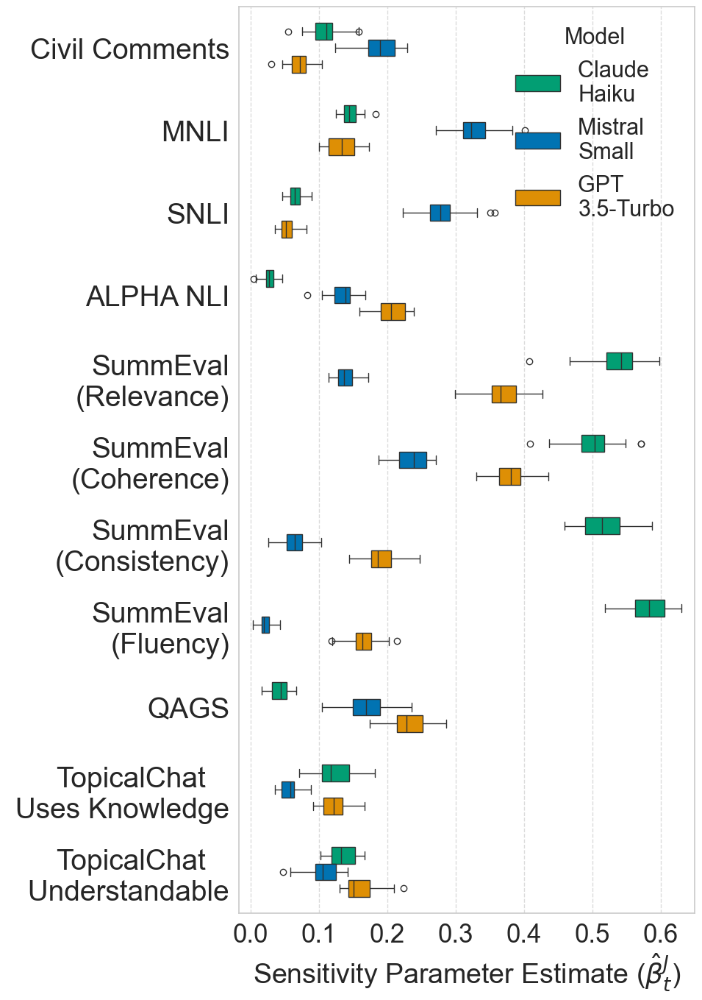

In [8]:
client = ModelAPIClient(tasks.TASK_CONFIGS, models.MODELS)

run_results = client.load_run(
    results_path=RUNS_DIR,
    run_tag='main-run',
    use_hf=True #Downloads existing run from HuggingFace. Set to False for loading an existing run.
)

visualizer = Visualizer()
df = visualizer.get_beta_distribution(run_results, n_samples=30, items_per_sample=100)

visualizer.plot_beta_distributions(
    df,
    plot_full=False, # Set to True for appendix version
    palette=models.MODEL_PALETTE,
    display_names=models.DISPLAY_NAMES,
)

plt.savefig(FIGURES_DIR / 'beta_distribution.pdf', dpi=500, bbox_inches='tight')


# Create illustrative rank inversion plot - Figure 6

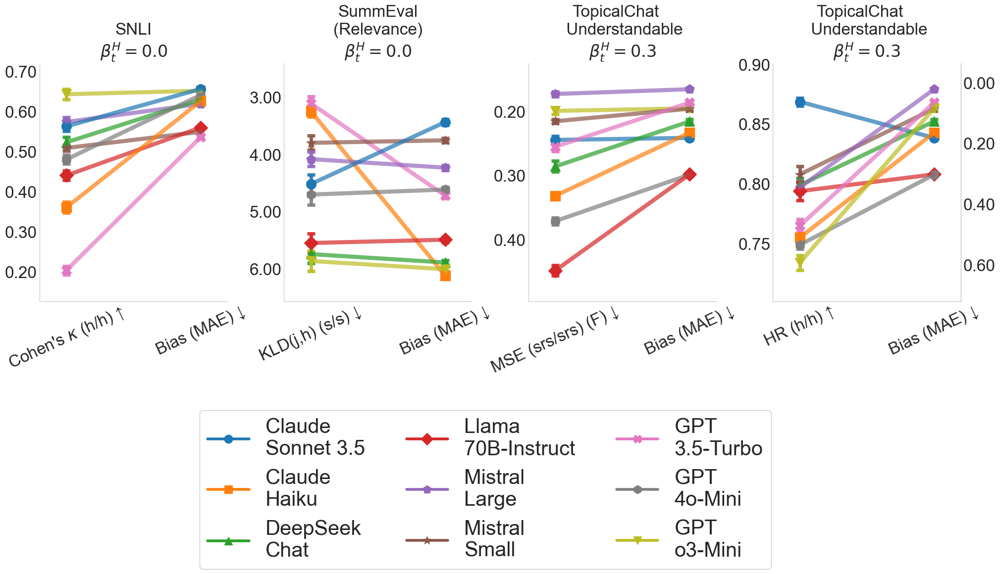

In [252]:
task_names = list(tasks.TASK_CONFIGS.keys())

all_metric_df = visualizer.all_task_raw_metric_df(
    run_results, 
    task_names=list(tasks.TASK_CONFIGS.keys()),
    betas=np.arange(0,.7,.1).round(2),
    taus=np.arange(0,1.1,.1),
    n_samples=10,
    items_per_sample=100
)

# Create the facit visualization
fig = visualizer.create_ranking_facit_plots(
    all_metric_df=all_metric_df,
    task_names_facit=['snli', 'summ_eval_relevance', 'topical_chat_understandable', 'topical_chat_understandable'],
    metrics_facit=['Cohen_kappa_h_h',  'KL_lh_s_s', 'MSE_srs_srs', 'HR_h_h', 'bias_mae'], # Last one is downstream_metric
    beta_1_values=[0.0,  0.0, 0.3, 0.3],
    beta_2_values=[0.0, 0.0, 0.3, 0.3],
    display_names=models.DISPLAY_NAMES,
    tau_value=0.5
)

plt.savefig(FIGURES_DIR / 'facit_rankings.pdf', dpi=400, bbox_inches='tight')


# Create task-specific ranking plots - Figures 11-21

/Users/lguerdan/Research/Indeterminacy/code/notebooks/../core/analysis.py:645: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(fig_width, 10))


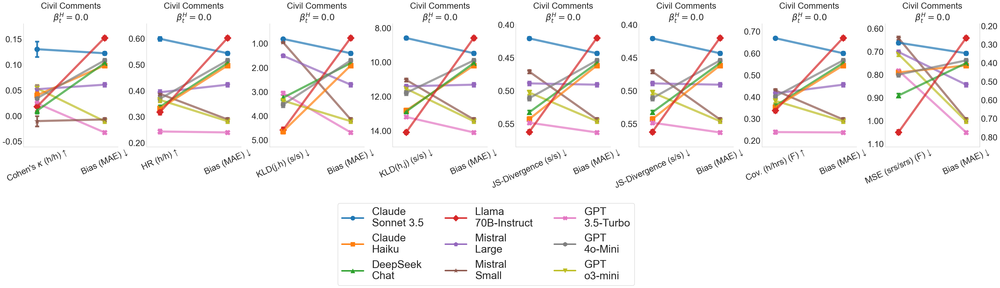

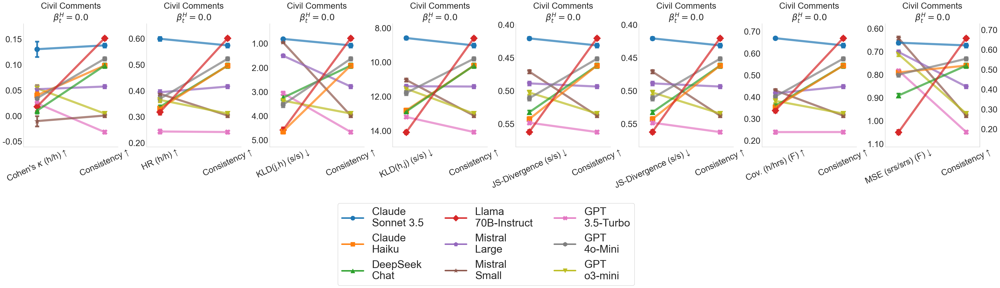

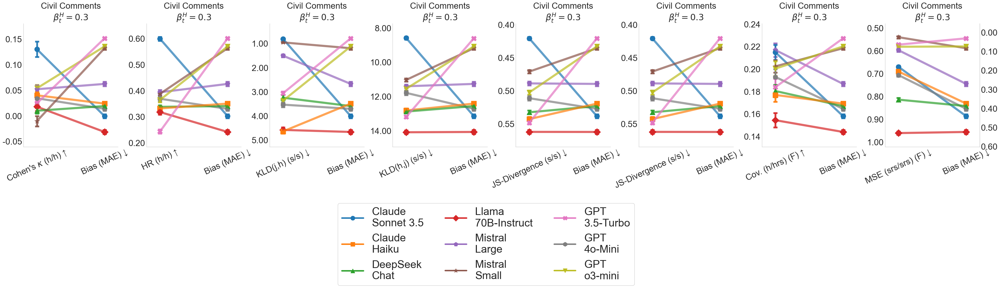

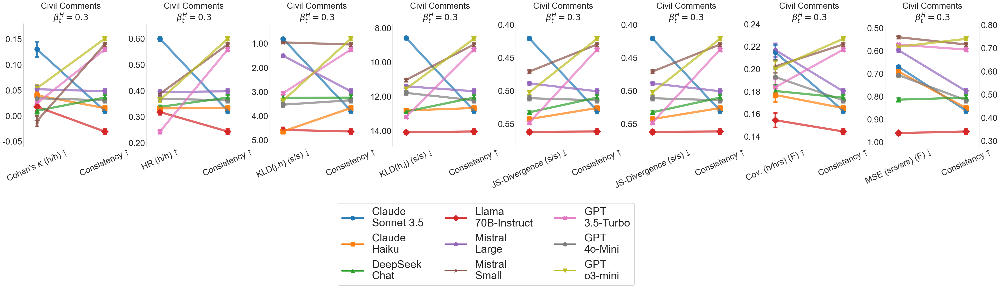

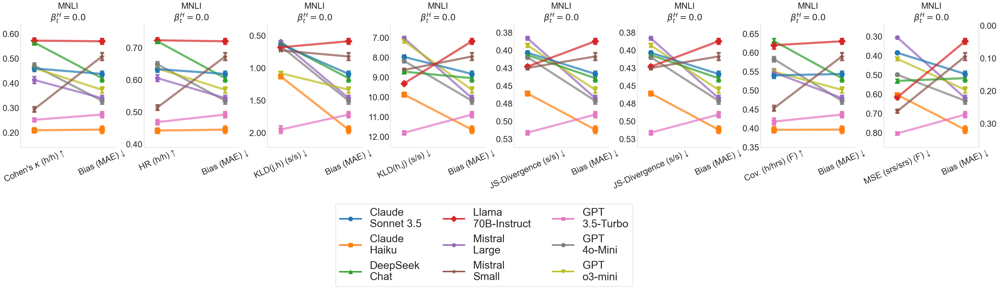

...

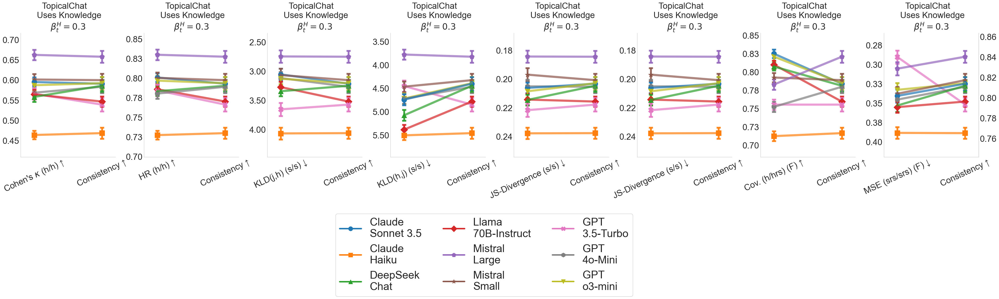

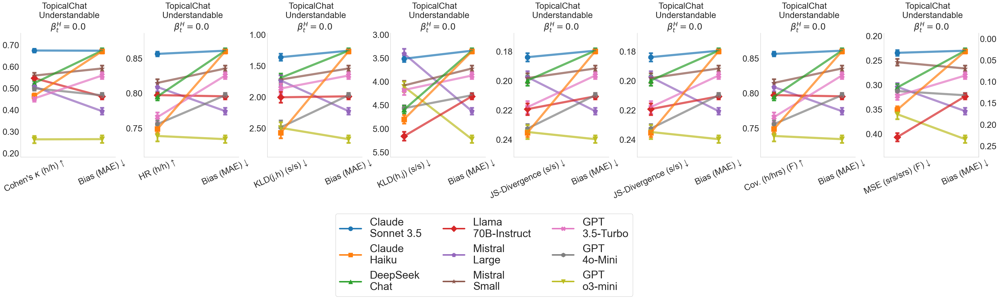

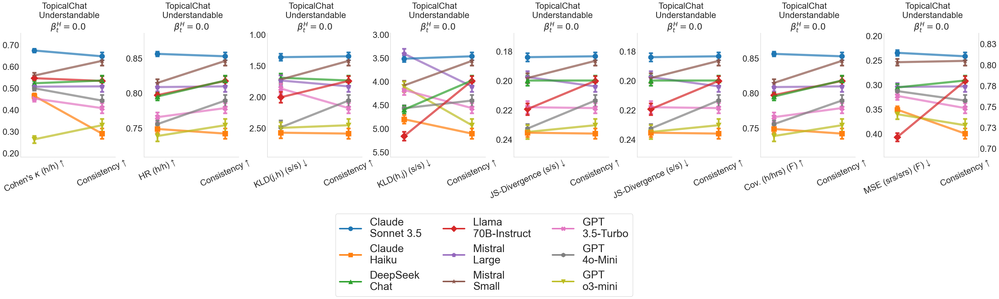

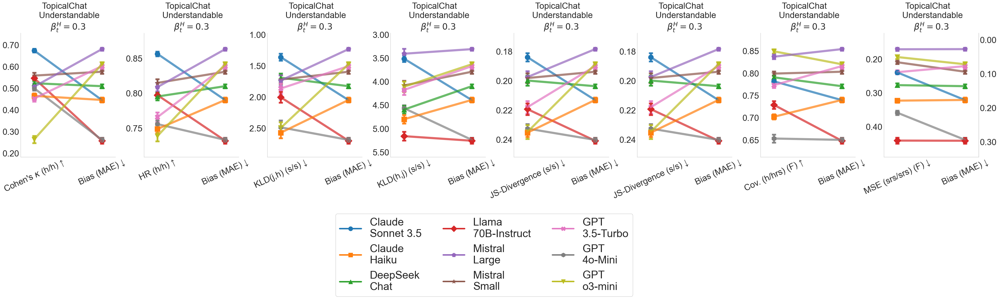

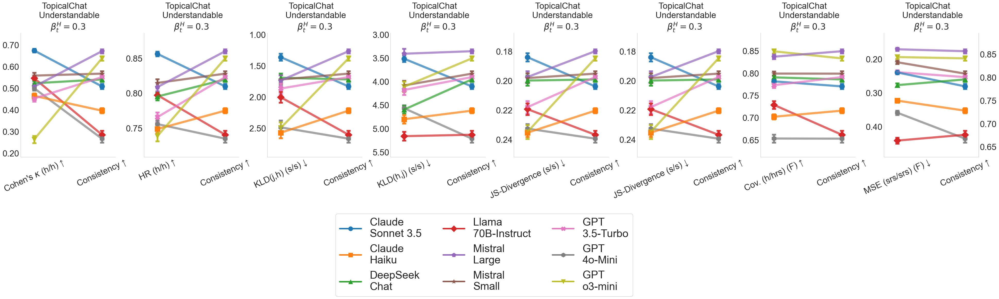

In [69]:
task_names = list(tasks.TASK_CONFIGS.keys())

for task_name in task_names:
    for beta in [0.0, 0.3]:
        for downstream_metric in ['bias_mae', 'consistency']:

            metrics_facit=['Cohen_kappa_h_h', 'HR_h_h', 'KL_lh_s_s','KL_hl_s_s', 'JSD_s_s', 'JSD_s_s', 'COV_h_hrs','MSE_srs_srs',  downstream_metric]

            # Create the facit visualization
            fig = visualizer.create_ranking_facit_plots(
                all_metric_df=all_metric_df,
                task_names_facit=[task_name for _ in range(len(metrics_facit))],
                metrics_facit=metrics_facit,
                beta_1_values=[beta for _ in range(len(metrics_facit))],
                beta_2_values=[beta for _ in range(len(metrics_facit))],
                display_names=models.DISPLAY_NAMES,
                tau_value=0.5
            )

            plt.savefig(FIGURES_DIR / f'facit_rankings_{task_name}_{beta}_{downstream_metric}.pdf', dpi=400, bbox_inches='tight')

